# Click and collapse to get all outputs and to start download of pictures

# Captum

In [ ]:
pip install git+https://github.com/pytorch/captum.git

In [ ]:
import torch
import torch.nn.functional as F

from PIL import Image

import os
import json
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

import torchvision
from torchvision import models
from torchvision import transforms

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz

## Get a model

In [ ]:
model = models.resnet18(pretrained=True)
model = model.eval()

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 193MB/s]


In [ ]:
!wget -P $HOME/.torch/models https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json


--2023-09-25 07:36:35--  https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.42.32, 52.216.145.253, 52.217.228.88, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.42.32|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35363 (35K) [application/octet-stream]
Saving to: ‘/root/.torch/models/imagenet_class_index.json’

imagenet_class_inde 100%[===================>]  34.53K   149KB/s    in 0.2s    

2023-09-25 07:36:36 (149 KB/s) - ‘/root/.torch/models/imagenet_class_index.json’ saved [35363/35363]



## Get class labels used by the model, select an image (manually upload your own for now)

In [ ]:
labels_path = os.getenv("HOME") + '/.torch/models/imagenet_class_index.json'
with open(labels_path) as json_data:
    idx_to_labels = json.load(json_data)

In [ ]:
# Run This to upload an image
from google.colab import files
from PIL import Image
import io

uploaded = files.upload()

# Assuming you've uploaded only one image
image_name = list(uploaded.keys())[0]
img = Image.open(io.BytesIO(uploaded[image_name]))


Saving da1.jpg to da1.jpg


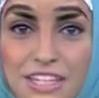

In [ ]:
img

In [ ]:
# Run this if you drag & dropped image to colab
# img = Image.open('/content/da1.jpg')

## Transform image

In [ ]:
transform = transforms.Compose([
 transforms.Resize(256),
 transforms.CenterCrop(224),
 transforms.ToTensor()
])

transform_normalize = transforms.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
 )

transformed_img = transform(img)

input = transform_normalize(transformed_img)
input = input.unsqueeze(0)

## Pass it through the pre-trained model, get top class prediction output for image

In [ ]:
output = model(input)
output = F.softmax(output, dim=1)
prediction_score, pred_label_idx = torch.topk(output, 1)

pred_label_idx.squeeze_()
predicted_label = idx_to_labels[str(pred_label_idx.item())][1]
print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

Predicted: bathing_cap ( 0.16070424020290375 )


## Use captum to output heatmaps using several methods

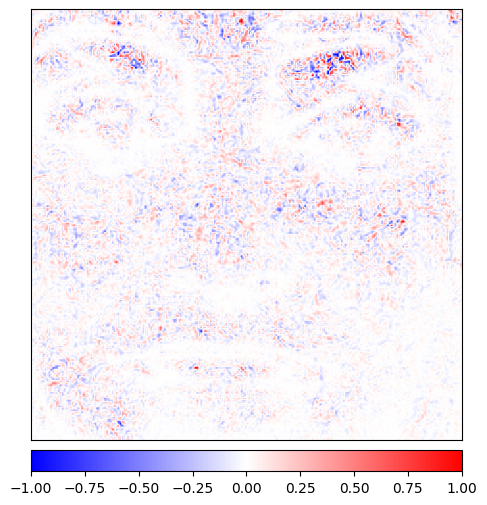

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

# Create a colormap that transitions from blue to white to red
blue_red_cmap = LinearSegmentedColormap.from_list(
    'blue_red',
    [(0, '#0000ff'), (0.5, '#ffffff'), (1, '#ff0000')]
)


integrated_gradients = IntegratedGradients(model)
attributions_ig = integrated_gradients.attribute(input, target=pred_label_idx, n_steps=200)

_ = viz.visualize_image_attr(np.transpose(attributions_ig.squeeze().cpu().detach().numpy(), (1,2,0)),
                             np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                             method='heat_map',
                             cmap=blue_red_cmap,
                             show_colorbar=True,
                             sign='all',   # visualize both positive and negative values
                             outlier_perc=1)


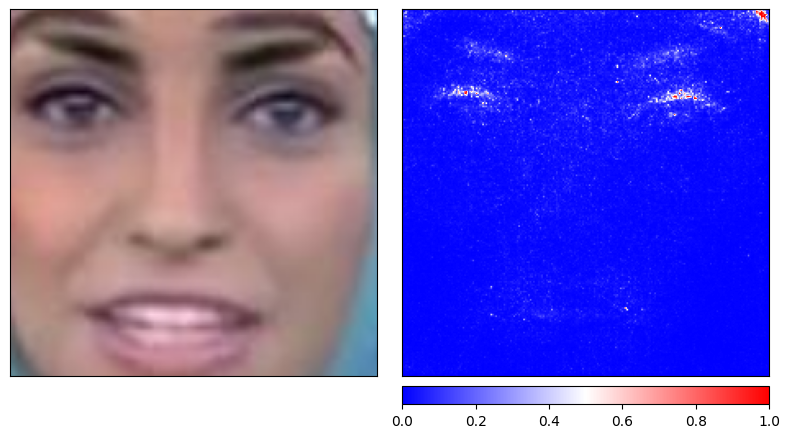

In [ ]:
noise_tunnel = NoiseTunnel(integrated_gradients)

attributions_ig_nt = noise_tunnel.attribute(input, nt_samples=10, nt_type='smoothgrad_sq', target=pred_label_idx)
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_ig_nt.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      cmap=blue_red_cmap,
                                      show_colorbar=True)

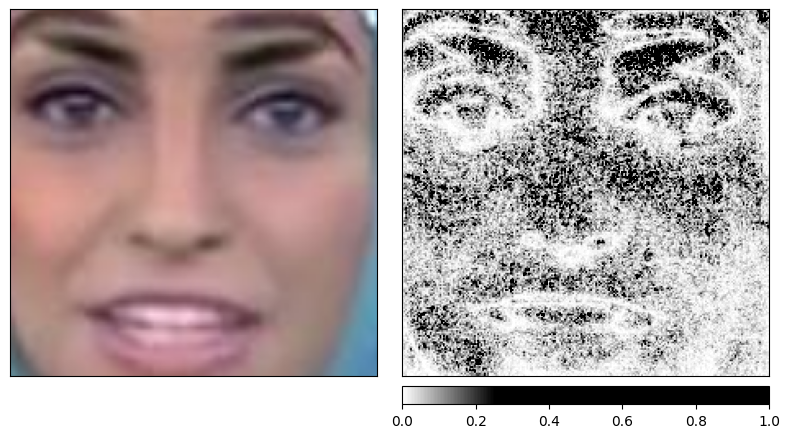

In [ ]:
torch.manual_seed(0)
np.random.seed(0)

gradient_shap = GradientShap(model)

# Defining baseline distribution of images
rand_img_dist = torch.cat([input * 0, input * 1])

attributions_gs = gradient_shap.attribute(input,
                                          n_samples=50,
                                          stdevs=0.0001,
                                          baselines=rand_img_dist,
                                          target=pred_label_idx)
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_gs.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "absolute_value"],
                                      cmap=default_cmap,
                                      show_colorbar=True)

In [ ]:
occlusion = Occlusion(model)

attributions_occ = occlusion.attribute(input,
                                       strides = (3, 8, 8),
                                       target=pred_label_idx,
                                       sliding_window_shapes=(3,15, 15),
                                       baselines=0)

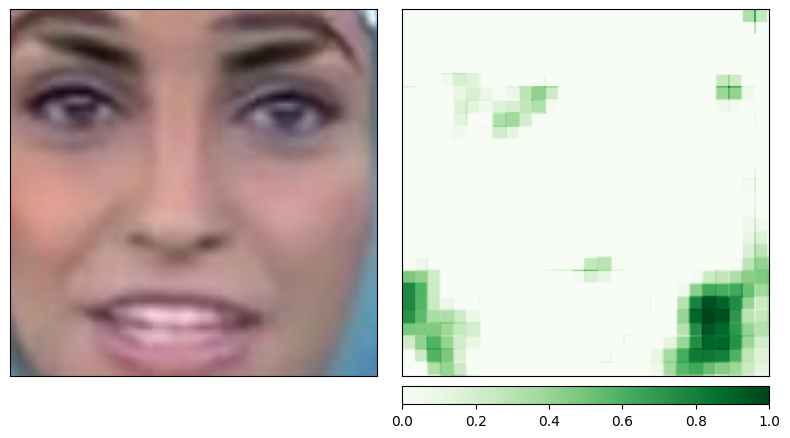

In [ ]:
_ = viz.visualize_image_attr_multiple(np.transpose(attributions_occ.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      show_colorbar=True,
                                      outlier_perc=2,
                                     )


# More captum stuff

In [ ]:
import torch
import torch.nn.functional as F

from PIL import Image

import os
import json
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
import os, sys
import json

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

import torchvision
from torchvision import models
from torchvision import transforms

from captum.attr import IntegratedGradients
from captum.attr import GradientShap
from captum.attr import Occlusion
from captum.attr import LayerGradCam
from captum.attr import NoiseTunnel
from captum.attr import visualization as viz
from captum.attr import LayerAttribution





In [ ]:
model = models.resnet18(pretrained=True)
model = model.eval()

In [ ]:
!wget -P $HOME/.torch/models https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
labels_path = os.getenv("HOME") + '/.torch/models/imagenet_class_index.json'
with open(labels_path) as json_data:
    idx_to_labels = json.load(json_data)

--2023-09-24 09:56:50--  https://s3.amazonaws.com/deep-learning-models/image-models/imagenet_class_index.json
Resolving s3.amazonaws.com (s3.amazonaws.com)... 52.216.35.32, 52.216.50.208, 52.217.202.16, ...
Connecting to s3.amazonaws.com (s3.amazonaws.com)|52.216.35.32|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 35363 (35K) [application/octet-stream]
Saving to: ‘/root/.torch/models/imagenet_class_index.json.1’

imagenet_class_inde 100%[===================>]  34.53K  --.-KB/s    in 0.09s   

2023-09-24 09:56:50 (403 KB/s) - ‘/root/.torch/models/imagenet_class_index.json.1’ saved [35363/35363]



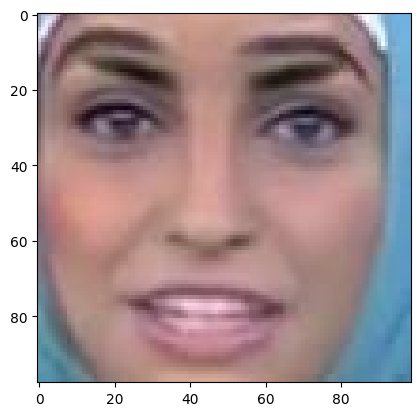

In [ ]:
test_img = Image.open('/content/da1.jpg')
test_img_data = np.asarray(test_img)
plt.imshow(test_img_data)
plt.show()

In [ ]:
# model expectation is 224x224 3-color image
transform = transforms.Compose([
 transforms.Resize(256),
 transforms.CenterCrop(224), #crop the given tensor image at the center
 transforms.ToTensor()
])
# ImageNet normalization
transform_normalize = transforms.Normalize(
     mean=[0.485, 0.456, 0.406],
     std=[0.229, 0.224, 0.225]
 )

img = Image.open('/content/da1.jpg')

transformed_img = transform(img)

input = transform_normalize(transformed_img)
#unsqueeze returns a new tensor with a dimension of size one inserted at the #specified position.
input = input.unsqueeze(0)

In [ ]:
#call our model
output = model(input)
## applied softmax() function
output = F.softmax(output, dim=1)
#torch.topk returns the k largest elements of the given input tensor along a given #dimension.K here is 1
prediction_score, pred_label_idx = torch.topk(output, 1)
pred_label_idx.squeeze_()
#convert into a dictionnary of keyvalues pair the predict label, convert it #into a string to get the predicted label
predicted_label = idx_to_labels[str(pred_label_idx.item())][1]
print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')

Predicted: bathing_cap ( 0.16070471704006195 )


In [ ]:
print('Predicted:', predicted_label, '(', prediction_score.squeeze().item(), ')')
#Create IntegratedGradients object and get attributes
integrated_gradients = IntegratedGradients(model)
#Request the algorithm to assign our output target to
attributions_ig = integrated_gradients.attribute(input, target=pred_label_idx, n_steps=200)

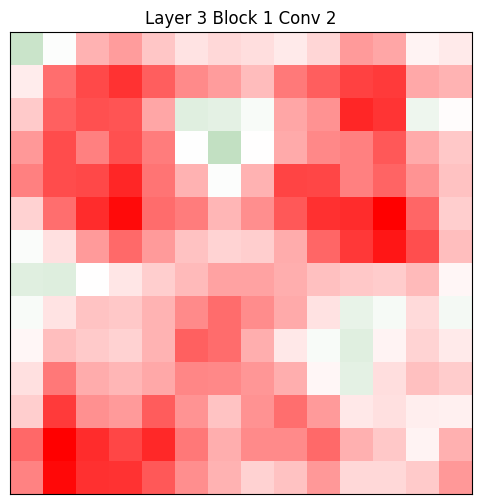

In [ ]:
layer_gradcam = LayerGradCam(model, model.layer3[1].conv2)
attributions_lgc = layer_gradcam.attribute(input, target=pred_label_idx)

_ = viz.visualize_image_attr(attributions_lgc[0].cpu().permute(1,2,0).detach().numpy(),
                             sign="all",
                             title="Layer 3 Block 1 Conv 2")

torch.Size([1, 1, 14, 14])
torch.Size([1, 1, 224, 224])
torch.Size([1, 3, 224, 224])


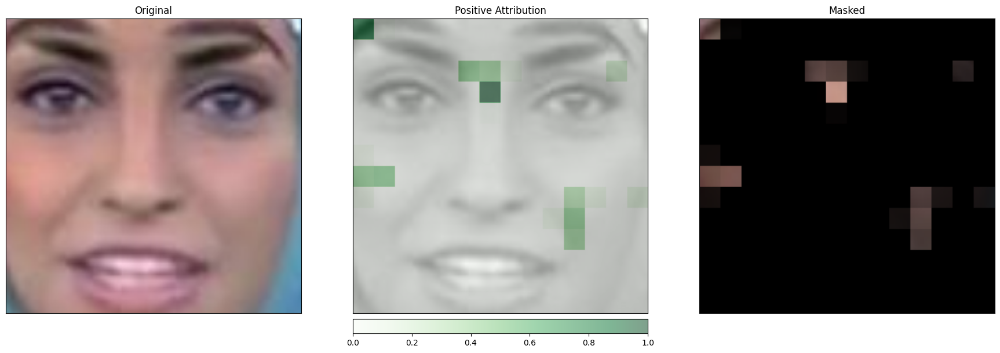

In [ ]:
upsamp_attr_lgc = LayerAttribution.interpolate(attributions_lgc, input.shape[2:])

print(attributions_lgc.shape)
print(upsamp_attr_lgc.shape)
print(input.shape)

_ = viz.visualize_image_attr_multiple(upsamp_attr_lgc[0].cpu().permute(1,2,0).detach().numpy(),
                                      transformed_img.permute(1,2,0).numpy(),
                                      ["original_image","blended_heat_map","masked_image"],
                                      ["all","positive","positive"],
                                      show_colorbar=True,
                                      titles=["Original", "Positive Attribution", "Masked"],
                                      fig_size=(18, 6))

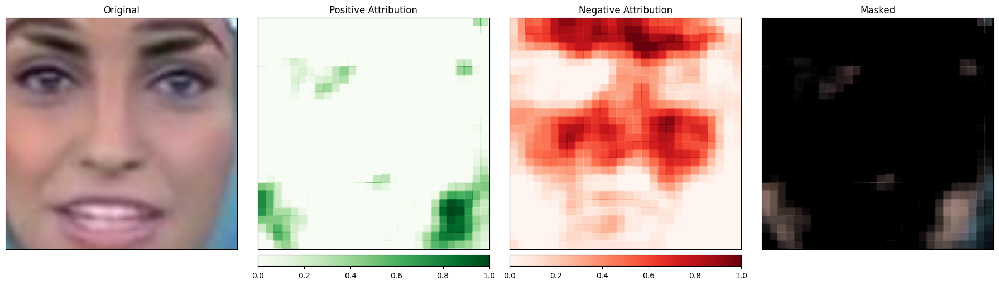

In [ ]:
occlusion = Occlusion(model)

attributions_occ = occlusion.attribute(input,
                                       target=pred_label_idx,
                                       strides=(3, 8, 8),
                                       sliding_window_shapes=(3,15, 15),
                                       baselines=0)


_ = viz.visualize_image_attr_multiple(np.transpose(attributions_occ.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map", "heat_map", "masked_image"],
                                      ["all", "positive", "negative", "positive"],
                                      show_colorbar=True,
                                      titles=["Original", "Positive Attribution", "Negative Attribution", "Masked"],
                                      fig_size=(18, 6)
                                     )

# Keras layer visualizations

In [ ]:
import matplotlib.pyplot as plt

def display_activations(activations, layer_names):
    for layer_name, activation in zip(layer_names, activations):
        # Number of features in the feature map
        n_features = activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // 15 + bool(n_features % 15)  # Compute number of columns, with each column showing 15 feature maps
        display_grid = np.zeros((size * 1, size * n_cols))

        for col in range(n_cols):
            for row in range(1):
                if (col * 15 + row) < n_features:
                    channel_image = activation[0, :, :, col * 15 + row]
                    # Post-process the feature to make it visually palatable
                    channel_image -= channel_image.mean()
                    channel_image /= channel_image.std()
                    channel_image *= 64
                    channel_image += 128
                    channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                    display_grid[row * size : (row + 1) * size, col * size : (col + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()


In [ ]:
Model

keras.src.engine.training.Model

In [ ]:
# Extracting names and outputs of the layers which have 'conv' in their names
layer_names = [layer.name for layer in model.layers if 'conv' in layer.name]
layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]

# Define a new model that will take an image as input and output the activations for these layers
activation_model = Model(inputs=model.input, outputs=layer_outputs)
activations = activation_model.predict(img_tensor)


1/1 [==============================] - 1s 1s/step


<ipython-input-18-12ad8fb8d62b>:21: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
<ipython-input-18-12ad8fb8d62b>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))


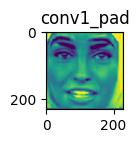

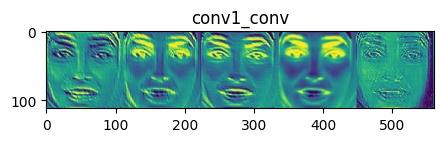

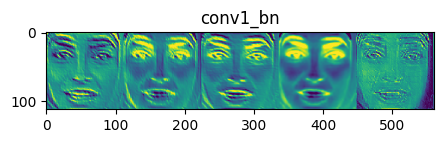

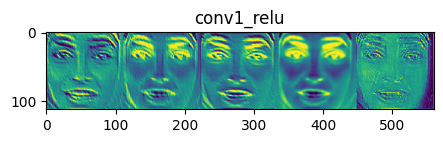

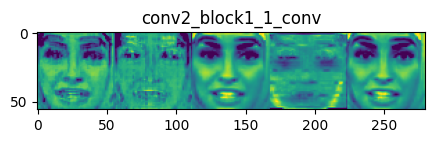

...

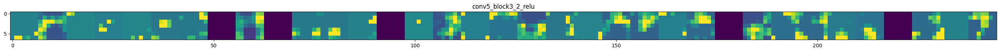

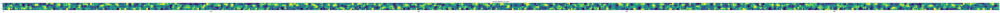

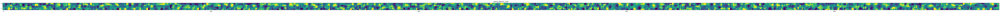

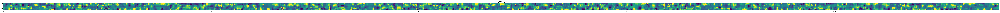

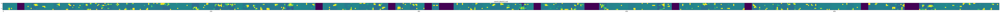

In [ ]:
display_activations(activations, layer_names)


In [ ]:
# Run this if u want to save all of those images 

# import os
# from keras.applications import resnet50
# from keras.preprocessing import image
# from keras.models import Model
# import numpy as np
# import matplotlib.pyplot as plt

# def load_and_preprocess_image(img_path):
#     img = image.load_img(img_path, target_size=(224, 224))
#     img_tensor = image.img_to_array(img)
#     img_tensor = resnet50.preprocess_input(img_tensor)
#     return np.expand_dims(img_tensor, axis=0)

# def extract_activations(model, img_tensor):
#     layer_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]
#     activation_model = Model(inputs=model.input, outputs=layer_outputs)
#     return activation_model.predict(img_tensor)

# def save_activations(activations, layer_names, save_dir, max_features_per_image=15):
#     if not os.path.exists(save_dir):
#         os.makedirs(save_dir)

#     for layer_name, activation in zip(layer_names, activations):
#         n_features = activation.shape[-1]
#         size = activation.shape[1]

#         # Determine the number of images required for the current layer's activations
#         n_images = n_features // max_features_per_image + bool(n_features % max_features_per_image)

#         for img_idx in range(n_images):
#             display_grid = np.zeros((size * 1, size * max_features_per_image))

#             for col in range(max_features_per_image):
#                 feature_map_idx = img_idx * max_features_per_image + col
#                 if feature_map_idx < n_features:
#                     channel_image = activation[0, :, :, feature_map_idx]
#                     channel_image -= channel_image.mean()
#                     channel_image /= channel_image.std()
#                     channel_image *= 64
#                     channel_image += 128
#                     channel_image = np.clip(channel_image, 0, 255).astype('uint8')
#                     display_grid[0 * size : 1 * size, col * size : (col + 1) * size] = channel_image

#             scale = 1. / size
#             plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
#             plt.title(f"Layer: {layer_name} - Image {img_idx+1}")
#             plt.xlabel("Feature Maps")
#             plt.ylabel("Channels")
#             plt.grid(False)
#             plt.imshow(display_grid, aspect='auto', cmap='viridis')

#             save_path = os.path.join(save_dir, f"{layer_name}_img{img_idx+1}.png")
#             plt.savefig(save_path)
#             plt.close()


# if __name__ == "__main__":
#     # Load the ResNet model
#     model = resnet50.ResNet50(weights='imagenet')

#     # Preprocess the input image
#     img_path = '/content/da1.jpg'
#     img_tensor = load_and_preprocess_image(img_path)

#     # Extract activations of the convolutional layers
#     layer_names = [layer.name for layer in model.layers if 'conv' in layer.name]
#     activations = extract_activations(model, img_tensor)

#     # Save the activation images
#     save_activations(activations, layer_names, save_dir="activation_images")

#     # Display the model summary
#     model.summary()


1/1 [==============================] - 1s 1s/step


<ipython-input-27-7a571f0a3745>:38: RuntimeWarning: invalid value encountered in divide
  channel_image /= channel_image.std()
